# Radiation Transfer Simulation with RADMC-3D

Credit: Akimasa Kataoka, Kiyoaki Doi, Cornelis Dullemond, Takashi Tsukagoshi, Jun Hashimoto

Pre-requisit:
  Users should have RADMC-3D installed.  See:
    http://www.ita.uni-heidelberg.de/~dullemond/software/radmc-3d/ 

## 4-1. Different Wavelengths

We have done the observation simulation at lambda=1300um (=1.3mm), which is observed with ALMA.  Here, we consider different wavelengths.
Near infrared is especially important since direct imaging observations of scattered light can be done with large ground-based telescopes such as Subaru, VLA and/or Gemini.

Note: The code cells in the following will overwrite .inp files.  Use differnt directories if you do not wat to do so.  For example:

Then, select "test2" folder in the browser and use the ipynb file in that directly.

Infrared imaging observations observe scattered light of the central star at the surface of the disk.
Polarized light is commonly used to distinguish from the direct light from the central star.
Therefore, following changes are made in the script for producing .inp files.
  - full theta grid is used, without assuming symmetry around the midplane
  - the opacity file contains the scattering information
  - the parameter scattering_mode_max is set to be five to include the effects of scattering
  - polarized intensity is used in the plot

In [27]:
""""""""""""""" PROBLEM SETUP """""""""""""""
# This code creates the protoplanetary disk structures and outputs as a set of files, 
# which will be input for later radiative transfer calculations by RADMC-3D.


import numpy as np
import os
import matplotlib.pyplot as plt

# ----------------------------------
#   Physical constants in cgs unit
# ----------------------------------

# Define useful constants.  
# Note that cgs units are commonly used in astronomy.
# Length is measured in [cm], mass is measured in [g], and time is measured in [s].


au  = 1.49598e13     # Astronomical Unit       [cm]
pc  = 3.08572e18     # Parsec                  [cm]
ms  = 1.98892e33     # Solar mass              [g]
ts  = 5.78e3         # Solar temperature       [K]
ls  = 3.8525e33      # Solar luminosity        [erg/s]
rs  = 6.96e10        # Solar radius            [cm]
ss  = 5.6703e-5      # Stefan-Boltzmann const  [erg/cm^2/K^4/s]
kb  = 1.3807e-16     # Bolzmann's constant     [erg/K]
mp  = 1.6726e-24     # Mass of proton          [g]
GG  = 6.67408e-08    # Gravitational constant  [cm^3/g/s^2]
pi  = np.pi          # Pi


''''''''''''' INPUT PARAMETER '''''''''''''''

# OFFSET = False

nr       = 120                       # Nr of radial grid points
nphi     = 100                       # Nr of azimuthual grid points 
ntheta   = 100                       # Nr of polar grid points

rin      = 1*au                     # Inner radius
rout     = 120*au                   # Outer radius

#INNER DISK
sigmad0   = 0.1                     # Sigma dust (in the middle of the Ring)  [*0.05 assuming a higher surface density]
ringcau1  = 7                       # R_{ring, center}: the radial location of the ring center in [au]
ringwau1  = 1                       # R_{ring, width}: the radial width of the ring in [au]
elevD     = 20                      # inner DISK elevation in DEGREES
rotaD1    = 300                     # inner DISK rotation in DEGREES (azimuthal rotation)

#TESTING
INNERASSYMETRIC = False
azipos1   = pi                      # inner DISK rotation of cresendent structur in RAD
azimwid1  = 0.45                    # inner DISK azimuthual width of cresendent structure in RAD

#OUTER DISK
sigmadc2  = 10                      # Sigma_{dust, center}: dust surface density at the center of the ring [g/cm^2]
ringcau2  = 88                      # R_{ring, center}: the radial location of the ring center in [au]
ringwau2  = 9                       # R_{ring, width}: the radial width of the ring in [au]
rotaD2    = 95                      # outer DISK rotation in (azimuthal rotation) & outer DISK rotation of cresendent structur in DEG

OUTERASSYMETRIC = True
azimwid2  = 0.75                   # outer DISK azimuthual width of cresendent structure in RAD


ELLIPSE = True
a_semi  = ringcau2 * au            # [cm] semi-major axis
e       = 0.2                      # eccentricity

 
nphot    = 2000000                 # Photones for Monte Carlo Simulation  



''' Star parameters '''

mstar    = ms * 2.2
rstar    = rs * 1.8
tstar    = ts + 3700  # K 
pstar    = np.array([0.,0.,0.])


''' Redefining inner Grid '''

def grid_refine_inner_edge(x_orig,nlev,nspan):
    x     = x_orig.copy()
    rev   = x[0]>x[1]
    for ilev in range(nlev):
        x_new = 0.5 * ( x[1:nspan+1] + x[:nspan] )
        x_ref = np.hstack((x,x_new))
        x_ref.sort()
        x     = x_ref
        if rev:
            x = x[::-1]
    return x


''' Make the r coordinates'''


nlev_rin = 20                 # Grid refinement at the inner edge: nr of cycles
nspan_rin= 5                 # Grid refinement at the inner edge: nr of cells each cycle
ri       = np.logspace(np.log10(rin),np.log10(rout),nr+1)
ri       = grid_refine_inner_edge(ri,nlev_rin,nspan_rin)   # Refinement at inner edge
rc       = 0.5 * ( ri[:-1] + ri[1:] )
nr       = len(rc)           # Recompute nr, because of refinement at inner edge


''' Make the theta and phi coordinates '''


thetaup  = 0.1
thetai   = np.linspace(thetaup,np.pi-thetaup,ntheta+1)
phii     = np.linspace(0.e0,np.pi*2.e0,nphi+1)
# thetac   = 0.5 * ( thetai[0:ntheta] + thetai[1:ntheta+1] )
# phic     = 0.5 * ( phii[0:nphi] + phii[1:nphi+1] )
thetac   = 0.5 * ( thetai[:-1] + thetai[1:] )
phic     = 0.5 * ( phii[:-1] + phii[1:] )


''' Make the 3-D-grid '''


qq       = np.meshgrid(rc,thetac,phic,indexing='ij')
r        = qq[0]   # The radial grid of the analytic disk model
tt       = qq[1]
pp       = qq[2]

ttdeg    = np.rad2deg(tt)
ppdeg    = np.rad2deg(pp)


"Calculating each component of the coordinates (r, phi, theta) of the rotated frame that belongs to the inner disk"


elevR    = np.deg2rad(elevD)        # Elevation of the disk in RAD
newr     = r
coselev  = (-np.sin(tt)*np.sin(pp)*np.sin(elevR))+(np.cos(tt)*np.cos(elevR))

newtt       = np.arccos(coselev)
sinnewpp    = np.sin(tt)*np.sin(pp)*np.cos(elevR)+np.cos(tt)*np.sin(elevR)/(np.sqrt(1-coselev**2))
sinnewtt    = np.sin(newtt)
cosnewpp    = (np.sin(tt)*np.cos(pp))/sinnewtt
newpp       = np.arctan2(sinnewpp,cosnewpp)
newpp       = np.where(newpp < 0, newpp + 2 * pi, newpp) #shifting atan2 domain from [-pi,pi] towards [0,2pi]


'''Rearranging the assymmetrical shape'''


dphi  =  newpp - azipos1

# dphi = np.where(dphi >= pi, dphi + 2*pi, dphi)
# dphi = np.where(dphi < 0, dphi + 2*pi, dphi)
# dphi[dphi < 0] += 2 * pi 
# if ((dphi>pi).all) or ((dphi<-pi).all):
#      dphi += 2*pi


''' Make the dust density model '''

#INNER DISK
q_inner  = 0.25
flang    = 0.1                         # The assumed constant radiative incidence angle
lstar    = 4*pi*rstar**2*ss*tstar**4   # Stellar luminosity L = sigma*A*T^4
firr     = flang*lstar/(4*pi*r**2)     # Irradiative flux F = L/A with A=4pi*r^2
tmid     = (firr/ss)**q_inner          # Estimate of midplane temperature (^0.25)
# ymid     = tmid_0 * (r/)
cs1      = np.sqrt(kb*tmid/(2.3*mp))   # Isothermal sound speed at midplane
omk      = np.sqrt(GG*mstar/r**3)      # The Kepler angular frequency
hp1      = cs1/omk                      # The pressure scale height
hpr1     = hp1/r                        # The dimensionless hp

#OUTER DISK
q_outer  = 0.25
flang    = 0.1                         # The assumed constant radiative incidence angle
lstar    = 4*pi*rstar**2*ss*tstar**4   # Stellar luminosity L = sigma*A*T^4
firr     = flang*lstar/(4*pi*r**2)     # Irradiative flux F = L/A with A=4pi*r^2
tmid2    = (firr/ss)**q_outer          # Estimate of midplane temperature (^0.25)

cs2      = np.sqrt(kb*tmid2/(2.3*mp))   # Isothermal sound speed at midplane
omk      = np.sqrt(GG*mstar/r**3)      # The Kepler angular frequency
hp2      = cs2/omk                      # The pressure scale height
hpr2     = hp2/r                        # The dimensionless hp

''' INNER DISK '''

ringc1    = ringcau1*au                # Convert [au] to [cm]
ringw1    = ringwau1*au                # Convert [au] to [cm]


if INNERASSYMETRIC==True:
    sigmad    = sigmad0 * np.exp(-((newr-ringc1)**2/ringw1**2)/2.0) * np.exp(-(((dphi)**2)/azimwid1**2)/2.0) # +  sigmad0 * np.exp(-((newr-ringc1)**2/ringw1**2)/2.0) * np.exp(-(((newpp - 1.8*pi)**2)/azimwid1**2)/2.0)     # radial & azimuthal surface density profile for ring [g/cm^2]
elif INNERASSYMETRIC==False:
    sigmad    = sigmad0 * np.exp(-((newr-ringc1)**2/ringw1**2)/2.0)                                                  # radial surface density profile for ring [g/cm^2]
 
newzr     = pi/2.e0 - newtt 

rhod     = ( sigmad / (np.sqrt(2.e0*np.pi)*hp1) ) * np.exp(-(newzr**2/hpr1**2)/2.e0)                                   # volume density

rotation1 = int((rotaD1-90)/(360/nphi))          
rhod     = np.roll(rhod, rotation1, axis=2)


''' OUTER DISK '''


ringc2 = ringcau2*au                      # Radius of the ring, Convert [au] to [cm] 

if ELLIPSE == True:
    ringc2_mod = a_semi*(1-e**2)/(1-e*np.cos(pp))
else:
    ringc2_mod = ringc2

ringw2  = ringwau2*au                   # Radial width of the ring, Convert [au] to [cm]

if OUTERASSYMETRIC==True:
    sigmad2   = sigmadc2  * np.exp(-((newr-ringc2_mod)**2/ringw2**2)/2.0) * np.exp(-((pp-1.05*pi)**2/azimwid2**2)/2.0) # radial & azimuthal surface density profile for ring [g/cm^2]
else:
    sigmad2   = sigmadc2  * np.exp(-((newr-ringc2_mod)**2/ringw2**2)/2.0)                                     # radial surface density profile for ring [g/cm^2]

zr        = np.pi/2.e0 - tt                                                      


rhod2     = ( sigmad2 / (np.sqrt(2.e0*np.pi)*hp2) ) * np.exp(-(zr**2/hpr2**2)/2.e0)                                   # volume density

rotation2 = int(rotaD2/(360/nphi))                                                                                  # only if assymetrical shape 
rhod2     = np.roll(rhod2, rotation2, axis=2)



''' ADDING OUTER & INNER DISK '''

rhod     += rhod2



#
# Write the grid file
#
with open('amr_grid.inp','w+') as f:
    f.write('1\n')                       # iformat
    f.write('0\n')                       # AMR grid style  (0=regular grid, no AMR)
    f.write('100\n')                     # Coordinate system: spherical
    f.write('0\n')                       # gridinfo
    f.write('1 1 1\n')                   # Include r,theta coordinates
    f.write('%d %d %d\n'%(nr,ntheta,nphi))  # Size of grid
    for value in ri:
        f.write('%21.14e\n'%(value))      # X coordinates (cell walls)
    for value in thetai:
        f.write('%21.14e\n'%(value))      # Y coordinates (cell walls)
    for value in phii:
        f.write('%21.14e\n'%(value))      # Z coordinates (cell walls)
        

#
# Write the density file
#
with open('dust_density.inp','w+') as f:
    f.write('1\n')                       # Format number
    f.write('%d\n'%(nr*ntheta*nphi))     # Nr of cells
    f.write('1\n')                       # Nr of dust species
    data = rhod.ravel(order='F')         # Create a 1-D view, fortran-style indexing
    data.tofile(f, sep='\n', format="%21.14e")
    f.write('\n')

    
    
# ----------------------------------
#
# Wavelength [um] data and create wavelength_micron.inp file
#
# ----------------------------------

lam1     = 0.1e0
lam2     = 7.0e0
lam3     = 25.e0
lam4     = 1.0e4
n12      = 20
n23      = 100
n34      = 30
lam12    = np.logspace(np.log10(lam1),np.log10(lam2),n12,endpoint=False)
lam23    = np.logspace(np.log10(lam2),np.log10(lam3),n23,endpoint=False)
lam34    = np.logspace(np.log10(lam3),np.log10(lam4),n34,endpoint=True)
lam      = np.concatenate([lam12,lam23,lam34])
nlam     = lam.size

#
# Write the wavelength file
#
with open('wavelength_micron.inp','w+') as f:
    f.write('%d\n'%(nlam))
    for value in lam:
        f.write('%21.14e\n'%(value))


#
# Write the stars.inp file
#
with open('stars.inp','w+') as f:
    f.write('2\n')
    f.write('1 %d\n\n'%(nlam))
    f.write('%21.14e %21.14e %21.14e %21.14e %21.14e\n\n'%(rstar,mstar,pstar[0],pstar[1],pstar[2]))
    for value in lam:
        f.write('%21.14e\n'%(value))
    f.write('\n%21.14e\n'%(-tstar))
    

#
# Dust opacity control file
#
with open('dustopac.inp','w+') as f:
    f.write('2               Format number of this file\n')
    f.write('1               Nr of dust species\n')
    f.write('============================================================================\n')
    f.write('10              Way in which this dust species is read\n')#[MODIFIED] opacity with scattering information
    f.write('0               0=Thermal grain\n')
    f.write('pyrmg70         Extension of name of dustkappa_***.inp file\n')#[MODIFIED] opacity with scattering information
    f.write('----------------------------------------------------------------------------\n')


#
# Write the radmc3d.inp control file
#
with open('radmc3d.inp','w+') as f:
    f.write('nphot = %d\n'%(nphot))
    f.write('scattering_mode_max = 5\n') #[MODIFIED] radiative transfer with scattring
    f.write('iranfreqmode = 1\n')

os.system('radmc3d mctherm')        #calling radmc3d and creating temperatur file  using the Monte Carlo method  

  
      WELCOME TO RADMC-3D: A 3-D CONTINUUM AND LINE RT SOLVER    
                                                                 
                          VERSION 2.0                            
                                                                 
                (c) 2008-2023 Cornelis Dullemond                 
                                                                 
       Please feel free to ask questions. Also please report     
        bugs and/or suspicious behavior without hestitation.     
      The reliability of this code depends on your vigilance!    
                    dullemond@uni-heidelberg.de                  
                                                                 
   To keep up-to-date with bug-alarms and bugfixes, follow the   
                     RADMC-3D code on github                     
             https://github.com/dullemond/radmc3d-2.0            
                                                                 
       

0

In [4]:
datatest = np.loadtxt('mg1.txt')
print(datatest.shape)
datatest2 = np.loadtxt('pyrmg60.txt')
print(datatest2.shape)
# wavmic, ncoef, kcoef = datatest2.T
# print(np.max(wavmic*1e-4))
# print(np.max(lam))

(4232, 3)
(109, 3)


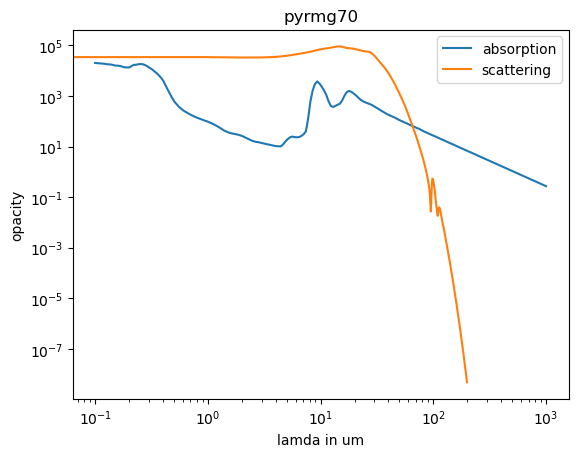

In [4]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming your .inp file is named "data.inp"
filename = "dustkapscatmat_pyrmg70.inp"

# Read the file and skip the first two rows
with open(filename, 'r') as f:
    lines = f.readlines()[10:]

# Extract the first and second columns
data = []
for line in lines[:200]:  # Limit to 500 elements
    columns = line.strip().split()
    data.append([float(columns[0]), float(columns[1]),float(columns[2])])

# Convert data to NumPy array
data_array = np.array(data)

# Separate x and y values
x = data_array[:, 0]
y = data_array[:, 1]
y2 = data_array[:, 2]

# Plot the data
plt.loglog(x, y, y2)
plt.legend(["absorption", "scattering"])
plt.ylabel("opacity")
plt.xlabel("lamda in um")
plt.title("pyrmg70")
plt.show()

In [ ]:
file_path = 'dust_temperature.dat'

nn =(nr*ntheta*nphi)+3
if os.path.exists(file_path):
    temp_values = []
    with open(file_path, 'r') as file:
        for i, line in enumerate(file, start=1):
            if 4 <= i <= (nn):
                # Convert the line to a float and append to the list
                temp_values.append(float(line.strip()))
            elif i > nn:
                break

    # Convert the list to an ndarray
    temp_array = np.array(temp_values)

    # Reshape the ndarray 
    temp_gen = temp_array.reshape((nr,ntheta,nphi))
else:
    print("The file 'dust_temperature.dat' does not exist.")

cs3       = np.sqrt(kb*temp_gen/(2.3*mp))   # Isothermal sound speed at midplane
omk       = np.sqrt(GG*mstar/r**3)          # The Kepler angular frequency
hp3       = cs3/omk                         # The pressure scale height
hpr3      = hp3/r
hp12      = abs(hpr3) - abs(hpr2)
hp_mean     =  np.mean(hp12)
print(f'This is the max/min value of the numerical [max={np.max(hpr3):.5f}, min={np.min(hpr3):.5f}] dimensionles pressure scale height.')
print(f'This is the max/min value of the analytical [max={np.max(hpr2):.5f}, min={np.min(hpr2):.5f}] dimensionles pressure scale height.')
print(f'This is the mean value of the numerical [{np.mean(hpr3):.5f}]')
print(f'This is the mean value of the analytical [{np.mean(hpr2):.5f}]')
print(f'Absolute mean diviation of the mean numercial PSH (true value) = {hp_mean:.5f}') 

  
      WELCOME TO RADMC-3D: A 3-D CONTINUUM AND LINE RT SOLVER    
                                                                 
                          VERSION 2.0                            
                                                                 
                (c) 2008-2023 Cornelis Dullemond                 
                                                                 
       Please feel free to ask questions. Also please report     
        bugs and/or suspicious behavior without hestitation.     
      The reliability of this code depends on your vigilance!    
                    dullemond@uni-heidelberg.de                  
                                                                 
   To keep up-to-date with bug-alarms and bugfixes, follow the   
                     RADMC-3D code on github                     
             https://github.com/dullemond/radmc3d-2.0            
                                                                 
       

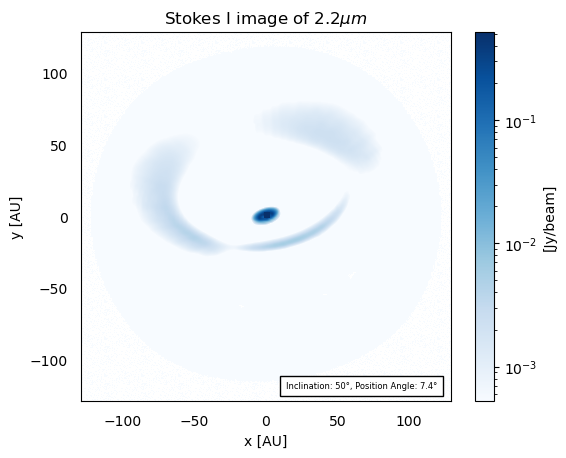

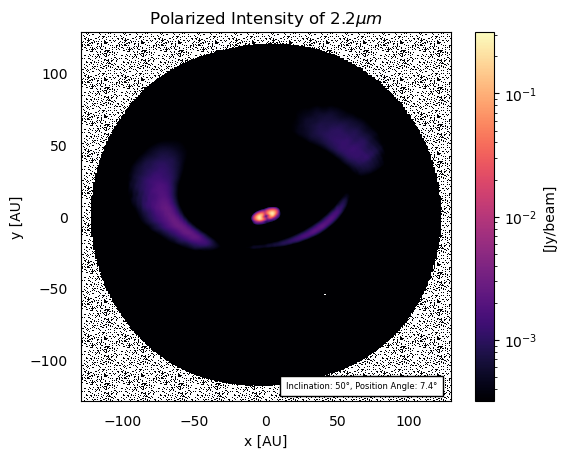

In [28]:
import numpy as np
import matplotlib as plt
# ------------------------------------------------
#
# Read the image.out file and visualize.
# First, set the image data file "image.out", which is the output of the RADMC-3D run.
# pixsize is the physical size of one pixel, which is determined by npix and sizeau in the RADMC-3D run, and is read from the file.
# Check the RADMC-3D manual for the structures of the image.out file
#    https://www.ita.uni-heidelberg.de/~dullemond/software/radmc-3d/manual_radmc3d/inputoutputfiles.html#output-image-out-or-image-out
#
# ------------------------------------------------
# The compared fits KS-band file provides us with a squared image of the size of 1024x1024 pixel. From the header you can extract 'cdelta' = 2.64*10^-6 deg/pixel. Knowing that the disk IRS48's 
# distance is d=136pc, we get 1.23 au/pixel. With this conversion factor you can now calculate the npix needed for an arbitrary size in au. 

cmd = 'radmc3d image lambda 2.2 npix 200 sizeau 258 incl 50 posang 7.4 nphot_scat 1000000 stokes setthreads 8'
os.system(cmd)

incl_value = cmd.split("incl ")[1].split()[0]
posang_value = cmd.split("posang ")[1].split()[0]

im_size       =  200/2
fnameread      = 'image.out'
imrangeau      =  [-im_size,im_size,-im_size,im_size]
with open(fnameread,'r') as f:
    s        = f.readline()
    im_n      = f.readline()
    im_nx     = int(im_n.split()[0])
    im_ny     = int(im_n.split()[1])
    nlam      = int(f.readline())
    pixsize   = f.readline()
    pixsize_x = float(pixsize.split()[0])
    pixsize_y = float(pixsize.split()[1])
    wavelength_mic = np.zeros(nlam)
    im    = np.zeros((im_nx,im_ny,4,nlam)) #[MODIFIED] array dimension modified for Stokes I,Q,U,V
    rr_au = np.zeros((im_nx,im_ny,4,nlam)) #[MODIFIED] array dimension modified for Stokes I,Q,U,V
    phi   = np.zeros((im_nx,im_ny,4,nlam)) #[MODIFIED] array dimension modified for Stokes I,Q,U,V
    for ilam in range(nlam): wavelength_mic[ilam] = f.readline()
    for ilam in range(nlam):
        dummy = f.readline() #blank line
        for iy in range(im_ny):
            for ix in range(im_nx):
                image_temp = f.readline()
                im[ix,iy,:,ilam] = [image_temp.split()[istokes] for istokes in [0,1,2,3]] #[MODIFIED] array dimension modified for Stokes I,Q,U,V
                rr_au[ix,iy,ilam] = np.sqrt(((ix-im_nx/2)*pixsize_x)**2+((iy-im_ny/2)*pixsize_y)**2)/au
                phi[ix,iy,ilam]   = np.arctan2((iy-im_ny/2)*pixsize_y,(ix-im_nx/2)*pixsize_x) 
sizex_au = im_nx*pixsize_x/au
sizey_au = im_ny*pixsize_y/au

#polarized intensity is stored in the array im_PI
im_PI = np.zeros((im_nx,im_ny,nlam,4))
im_PI = ((im[:,:,1,0])**2.0 + (im[:,:,2,0])**2.0)**0.5


# ------------------------------------------------
#
# Beam convolution
# Convolve the image with the Gaussian beam [commented out by default]
#
# ------------------------------------------------


'''
from scipy.ndimage import gaussian_filter
im_smoothed = gaussian_filter(im,10)
'''



# ------------------------------------------------
#
# Conversion of the intensity unit
#
#  The array im contains the intensity of each pixel in cgs units, [erg/s/cm/cm/Hz/ster].
#  For comparison with actual observations, this needs to be converted to observed units, which depend on observations.
#  Below are several examples.
#
#
# parameters:
#
# distance to the object
d_pc = 136   # For IRS48 first measured 121 pc, which got updated to 136pc
#
# beam size for submilimeter 
# Value in arsec  = Value in deg * 60 * 60
# Bmaj_as        = 0.11 # Major axis of the beam in arcsec
# Bmin_as        = 0.072 # Minor axis of the beam in arcsec
# beam size for NIR 
# Value in arsec  = Value in deg * 60 * 60
Bmaj_as        = 0.07 # Major axis of the beam in arcsec
Bmin_as        = 0.07 # Minor axis of the beam in arcsec
wavelength     = 0.00022  # wavelength in unit of cm
#
# ------------------------------------------------



# ------------------------------------------------
# parameters:
#
# distance to the object
# 地球に届く天体の明るさを計算するときは、天体までの距離の情報が必要です。
# (天体から地球までの距離が遠ければ遠いほど暗いので)
# ------------------------------------------------


# im_Jyppix : intensity with a unit of [Jy/pixel]
# Conversion from erg/s/cm/cm/Hz/ster to Jy/pixel
#

# conv          = pixsize_x * pixsize_y / (d_pc*pc)**2. * 1e23 
# im_forplot    = im[:,:,:,0].copy()*conv
# im_PI_forplot = im_PI.copy()*conv
# pltunit       = '[Jy/pix]'


# im_Jypas2 : intensity with a unit of [Jy/arcsec^2]
# 1 arcsec of the object at the distance of d_pc [pc] corresponds to d_pc [au]
'''
conv       = pixsize_x * pixsize_y / (d_pc*pc)**2. * 1e23 * (pixsize_x/au*d_pc)*(pixsize_y/au*d_pc)
print('plotting with the unit of [Jy/arcsec^2]')
print('ref: arcsec^2 in the unit of au^2 = ',  (pixsize_x/au*d_pc)*(pixsize_y/au*d_pc))
im_Jypas2  = np.zeros((im_nx,im_ny,nlam))
im_Jypas2  = im.copy()*conv
im_forplot = im_Jypas2
pltunit    = '[Jy/arcsec^2]'
'''

# im_Jypbeam : intensity with a unit of [Jy/beam]
# beam size: Full Width of Half Maximum of the beam
# beam size = pi/(4 log(2)) * Bmaj * Bmin


Bmajinpix       = Bmaj_as*pixsize_x/au*d_pc
Bmininpix       = Bmin_as*pixsize_x/au*d_pc
pixelinbeam     = (np.pi/4.0/np.log(2.0))*Bmajinpix*Bmininpix
print('plotting with the unit of [Jy/beam]')
print('Bmaj, Bmin = ',  Bmaj_as, ',', Bmin_as, 'in arcseconds')
conv           = pixsize_x * pixsize_y / (d_pc*pc)**2. * 1e23 * pixelinbeam
print('ref: how many pixels in one beam?:', pixelinbeam)
im_Jypbeam     = np.zeros((im_nx,im_ny,nlam))
im_Jypbeam     = im.copy()*conv
im_PI_forplot  = im_PI.copy()*conv
im_forplot     = im_Jypbeam
pltunit        = '[Jy/beam]'



# im_BT_RJ  : intensity with a unit of brightness temperature in RJ limit [K]
# surface brightness in units of Kelvin, converted using Planck Function
# Here, Rayleigh-Jeans limit of Planck Function is used
# see:
#   https://science.nrao.edu/facilities/vla/proposing/TBconv
'''
conv           = wavelength*wavelength/kb/2.0
im_TB_RJ       = np.zeros((im_nx,im_ny,nlam))
im_TB_RJ       = im.copy()*conv
im_forplot     = im_TB_RJ
pltunit        = '[K]'
'''


# ------------------------------------------------
#
# Plotting the image...
#
# 以下、図をプロットするための情報です。
# intmax,intminは表示画像の最大値・最小値を表します。
# もし画像に何も見えない場合はここを変更してみてください。
# ------------------------------------------------


import math
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
%matplotlib inline



# Plotting the Stokes I image...

fontsize       = 12
fontfamily     = 'serif'
interpolation  = 'bicubic'
cmap           = 'Blues'
intmax         =  np.max(im_forplot[np.where(im_forplot<np.max(im_forplot)*0.1)])
#the maximum value of the plot is set to 0.1 times the brightest pixel. 
#the brightest pixel is where the star is.
#the disk is much fainter, so the color scale should be set appropriately for the disk to be visibile
intmin         =  intmax*0.001    #--> 0.01 is the default value and I changed it to 0.001 inorder to get better scattering image 
tickcolor      = 'white'
xlabel         = 'x [AU]'
ylabel         = 'y [AU]'
norm           =  None
drawpolvect    =  False
title          = f'Stokes I image of {float(wavelength_mic[0])}$\mu m$' 

# fig=plt.figure(num=None, figsize=(8,6), dpi=400, facecolor='w', edgecolor='k')  #used in the old code?!
# ax1=fig.add_subplot(111)                                                        #used in the old code?!
plt.figure()
norm=LogNorm(vmin=intmin, vmax=intmax)
#norm=None
plt.imshow(im_forplot[:,:,0,0].T,interpolation=interpolation, cmap=cmap,norm=norm,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])

plt.xlabel(xlabel)
plt.ylabel(ylabel)
# plt.xlim(imrangeau[0],imrangeau[1])
# plt.ylim(imrangeau[2],imrangeau[3])
plt.title(title)
plt.tick_params(which='major', color=tickcolor,width=2.0,length=6.0)
plt.text(x=14, y=-120, s=f"Inclination: {incl_value}°, Position Angle: {posang_value}°", fontsize=6, bbox=dict(facecolor='white', alpha=1))
#
# Setting the colorbar
#
cbar=plt.colorbar()
cbar.set_label(pltunit)

plt.savefig('pictures/irplot3.1.pdf')

# Plotting the Polarized Intensity image...

fontsize       = 12
fontfamily     = 'serif'
interpolation  = 'bicubic'
cmap           = 'magma'
intmax         =  np.max(im_PI_forplot)
intmin         =  np.max(im_PI_forplot)*0.001
tickcolor      = 'white'
xlabel         = 'x [AU]'
ylabel         = 'y [AU]'
norm           =  None
drawpolvect    =  False
title          = f'Polarized Intensity of {float(wavelength_mic[0])}$\mu m$' 


plt.figure()
norm=LogNorm(vmin=intmin, vmax=intmax)
#norm=None
simu_data = im_PI_forplot[:,:].T

plt.imshow(simu_data,interpolation=interpolation,cmap=cmap,norm=norm,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])

plt.xlabel(xlabel)
plt.ylabel(ylabel)
# plt.xlim(imrangeau[0],imrangeau[1])
# plt.ylim(imrangeau[2],imrangeau[3])
plt.title(title)
plt.tick_params(which='major', color=tickcolor,width=2.0,length=6.0)

plt.text(x=14, y=-120, s=f"Inclination: {incl_value}°, Position Angle: {posang_value}°", fontsize=6, bbox=dict(facecolor='white', alpha=1))

#
# Setting the colorbar
#
cbar=plt.colorbar()
cbar.set_label(pltunit)

plt.savefig('pictures/irplot3.2.pdf')



The scale of the fits image is 1.293 au/pixel.


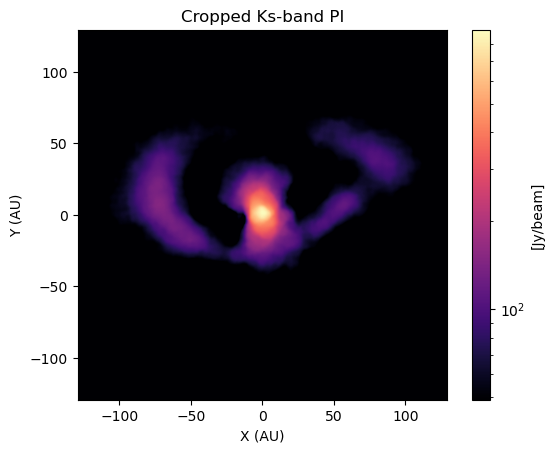

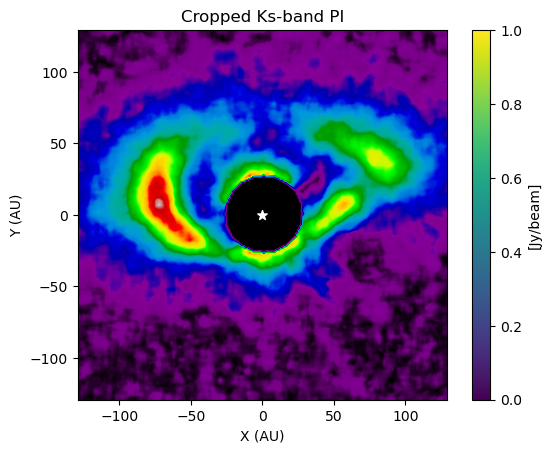

In [29]:
from astropy.io import fits
import numpy as np
from tabulate import tabulate
import math
from matplotlib.colors import LogNorm

# import matplotlib.colors as cl
import matplotlib.pyplot as plt
# fits_image_filename1 = fits.util.get_testdata_filepath('irs48.r0.5.StokesI.image.pbcor copy.fits')
fits_image_filename2 = fits.open('wly2-48_Ksband_PI.fits')

with fits_image_filename2 as hdul:              # open a FITS file
    data = hdul[0].data                         # assume the first extension is an image

    # Extract the scale in degrees per pixel
    header = hdul[0].header
    secpix = header.get('SECPIX', None)         # Using CDELT1 as an example; you might need CDELT2 or CD matrix elements depending on your file


# subdata = data[510:515, 510:515]
# row_labels = [f"y={i}" for i in range(510, 515)]
# col_labels = [f"x={i}" for i in range(510, 515)]

# table_data = subdata.tolist()
# for row_label, row_data in zip(row_labels, table_data):
#     row_data.insert(0, row_label)

# table_data.insert(0, [""] + col_labels)
# print(tabulate(table_data, headers='firstrow', tablefmt='grid'))

d_pc = 136
au_pixel = round(d_pc * secpix,3)     # converting arcsec/pixel -> au/pix, distance in parsec needed! 
print(f'The scale of the fits image is {au_pixel} au/pixel.')


# data_au = data                

center_x, center_y = 512, 512
new_size = 200           

# Calculate the cropping boundaries
start_x = center_x - new_size // 2
start_y = center_y - new_size // 2
end_x = start_x + new_size
end_y = start_y + new_size

# Crop the image
c_data = data[start_y:end_y, start_x:end_x]

new_size_au = np.size(c_data[0]) * au_pixel   #pixel -> au

# Plotting
intmax   =  np.max(c_data)
# intmax   =  np.max(c_data[np.where(c_data<np.max(c_data)*0.1)])
intmin   =  np.max(c_data)*0.055
LogNorm(vmin=intmin, vmax=intmax)
# norm = plt.Normalize(vmin=intmin, vmax=intmax)

plt.figure()
plt.imshow(c_data,cmap = 'magma',interpolation  = 'bicubic', norm=LogNorm(vmin=intmin, vmax=intmax),origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
plt.title('Cropped Ks-band PI')
plt.xlabel('X (AU)')
plt.ylabel("Y (AU)")

cbar =plt.colorbar()
cbar.set_label('[Jy/beam]')

import tools

new_c_data1 = tools.circular_mask(c_data, radius=21)                         #MASKING R=30 AU

plt.figure()
plt.imshow(new_c_data1,cmap = 'nipy_spectral',interpolation  = 'bicubic', norm=None,origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
plt.title('Cropped Ks-band PI')
plt.xlabel('X (AU)')
plt.ylabel("Y (AU)")
plt.scatter(0, 0, color='white', s=50, marker='*')
cbar =plt.colorbar()
cbar.set_label('[Jy/beam]')


# data_norm = (c_data-c_data.min())/(c_data.max() - c_data.min())      #NORMALIZATION

# plt.figure()
# plt.imshow(data_norm,cmap = 'magma',origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])

# plt.title('Normalized cropped Ks-band PI')
# # plt.xlim(-100,100)
# # plt.ylim(-100,100)
# plt.xlabel('X (AU)')
# plt.ylabel("Y (AU)")

# cbar =plt.colorbar()
# cbar.set_label('Normalized')

# '''ORIGINAL'''

# plt.figure()
# plt.imshow(c_data,cmap = 'magma',origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])

# plt.title('Cropped Ks-band PI')
# # plt.xlim(-100,100)
# # plt.ylim(-100,100)
# plt.xlabel('X (AU)')
# plt.ylabel("Y (AU)")

# cbar =plt.colorbar()
# cbar.set_label('[Jy/beam]')




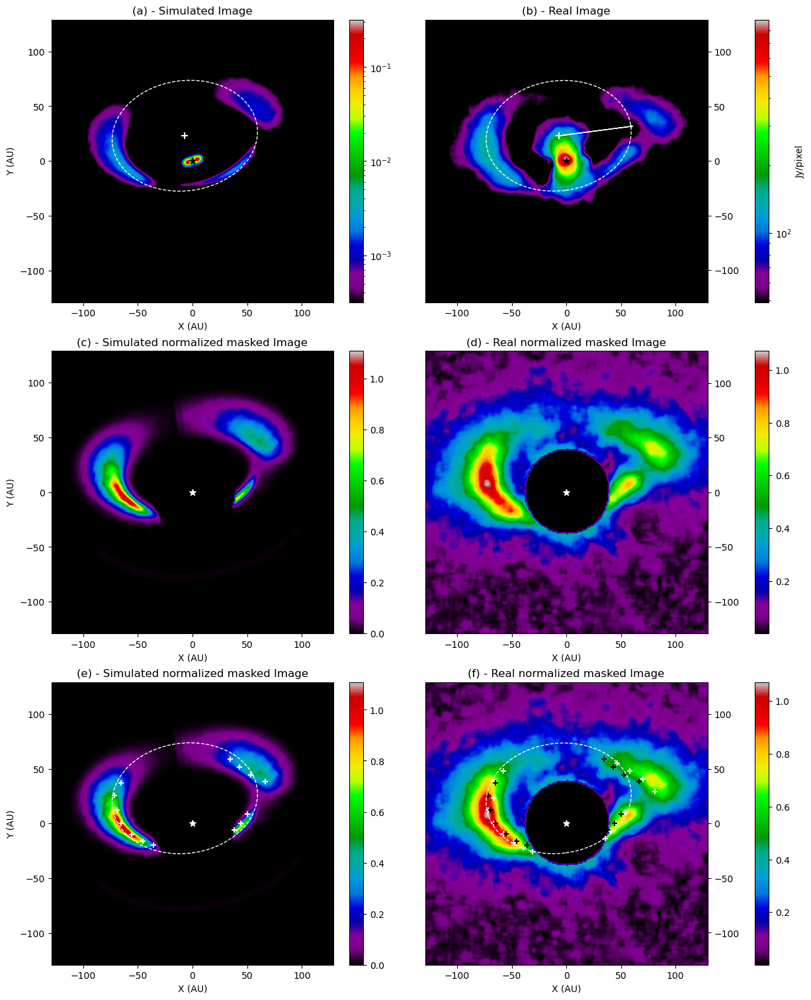

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from decimal import Decimal
import matplotlib.patches as ptch
import tools
import importlib

importlib.reload(tools)



simu_data = np.where(simu_data<10**(-15),10**-15 , simu_data.copy())
# c_data = np.where(c_data<13, 1, c_data.copy())

# Display all images 
fig, ax = plt.subplots(3, 2, figsize=(12, 15), constrained_layout=True)

#FIG1
im1 = ax[0,0].imshow(simu_data,interpolation=interpolation,cmap='nipy_spectral',norm=norm,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
ax[0,0].set_title('(a) - Simulated Image')
ax[0,0].set_xlabel('X (AU)')
ax[0,0].set_ylabel('Y (AU)')
ax[0,0].axis('on')
#Ellipse fit [best fit: extracted from Follette et al. e=66, a=0.49", b=0.37", PA=97, center=(-5,+18)] -> converted pixel, arcsec into au (*136pc | *1.23 au/pixel)
ellipse = ptch.Ellipse(xy=[-7, 23], width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[0,0].add_patch(ellipse)
ax[0,0].scatter(-7, 23, color='white', s=50, marker='+')
ax[0,0].scatter(0, 0, color='black', s=50, marker='*')
fig.colorbar(im1, ax=ax[0,0], location='right')

#FIG2
im2 = ax[0,1].imshow(c_data,cmap = 'nipy_spectral',interpolation  = 'bicubic', norm=LogNorm(vmin=intmin, vmax=intmax),origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
ax[0,1].set_title('(b) - Real Image')
ax[0,1].set_xlabel('X (AU)')
ax[0,1].yaxis.tick_right()
ax[0,1].axis('on')
#Ellipse fit [best fit: extracted from Follette et al. e=66, a=0.49", b=0.37", PA=97, center=(-5,+18)] -> converted pixel, arcsec into au (*136pc | *1.23 au/pixel)
center_au=[-7, 23]
ellipse = ptch.Ellipse(xy=center_au, width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[0,1].add_patch(ellipse)
ax[0,1].scatter(center_au[0], center_au[1], color='white', s=50, marker='+')
ax[0,1].scatter(0, 0, color='black', s=50, marker='*')
# End point calculation for the semi-major axis vector, considering the rotation
end_point_x = center_au[0] + 54*1.23 * math.cos(np.deg2rad(7.4))
end_point_y = center_au[1] + 54*1.23 * math.sin(np.deg2rad(7.4))
ax[0,1].arrow(center_au[0], center_au[1], end_point_x - center_au[0], end_point_y - center_au[1], head_width=2, head_length=2, fc='white', ec='white')
fig.colorbar(im2, ax=ax[0,1], location='right', label='Jy/pixel')



pos1, pos2 = -100, +100       # along x, default y = 100 (middle)
pos1 += 100
pos2 += 100 

'''Fiure 3,4 normalized masked IMAGES/PLOTS'''


new_simu_data = tools.circular_mask(simu_data, radius=30)                   #MASKING R=30 AU
new_c_data = tools.circular_mask(c_data, radius=30)                         #MASKING R=30 AU

nor_simu_data = new_simu_data / np.max(new_simu_data, axis=1)[100]           #NORMALIZATION
nor_c_data = new_c_data / np.max(new_c_data, axis=1)[100]                    #NORMALIZATION

#1dim array range
pos1, pos2 = -100, +100       # along x, default y = 100 (middle)
pos1 += 100
pos2 += 100 

#FIG3
im3 = ax[1,0].imshow(nor_simu_data,cmap = 'nipy_spectral',interpolation='bicubic',norm=None,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
ax[1,0].set_title('(c) - Simulated normalized masked Image')
ax[1,0].set_xlabel('X (AU)')
ax[1,0].set_ylabel('Y (AU)')
ax[1,0].axis('on')
ax[1,0].scatter(0, 0, color='white', s=50, marker='*')
fig.colorbar(im3, ax=ax[1,0], location='right')

#FIG4
im4 = ax[1,1].imshow(nor_c_data,cmap = 'nipy_spectral',interpolation='bicubic', norm=None,origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
ax[1,1].set_title('(d) - Real normalized masked Image')
ax[1,1].set_xlabel('X (AU)')
ax[1,1].yaxis.tick_right()
ax[1,1].axis('on')  
ax[1,1].scatter(0, 0, color='white', s=50, marker='*')
fig.colorbar(im4, ax=ax[1,1], location='right')

#FIG5
im3 = ax[2,0].imshow(nor_simu_data,cmap = 'nipy_spectral',interpolation='bicubic',norm=None,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
ax[2,0].set_title('(e) - Simulated normalized masked Image')
ax[2,0].set_xlabel('X (AU)')
ax[2,0].set_ylabel('Y (AU)')
ax[2,0].axis('on')
ax[2,0].scatter(0, 0, color='white', s=50, marker='*')
fig.colorbar(im3, ax=ax[2,0], location='right')
tools.trace_outer_ring(nor_simu_data,degrees_step=10,ax=ax, grid_x= 2, grid_y=0,int_threshold=0.2)
ellipse = ptch.Ellipse(xy=[-7, 23], width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[2,0].add_patch(ellipse)
# tools.trace_outer_ring(nor_c_data,ax=ax, grid_x= 2, grid_y=0,int_threshold=0.5, color='blue')

#FIG6
im4 = ax[2,1].imshow(nor_c_data,cmap = 'nipy_spectral',interpolation='bicubic', norm=None,origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
ax[2,1].set_title('(f) - Real normalized masked Image')
ax[2,1].set_xlabel('X (AU)')
ax[2,1].yaxis.tick_right()
ax[2,1].axis('on')  
ax[2,1].scatter(0, 0, color='white', s=50, marker='*')
fig.colorbar(im4, ax=ax[2,1], location='right')
max_intensity_points1 =tools.trace_outer_ring(nor_c_data,degrees_step=10,ax=ax, grid_x= 2, grid_y=1,int_threshold=0.50)
max_intensity_points2 =tools.trace_outer_ring(nor_simu_data,degrees_step=10,ax=ax, grid_x= 2, grid_y=1,int_threshold=0.2,color = 'black')
ellipse = ptch.Ellipse(xy=[-7, 23], width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[2,1].add_patch(ellipse)

plt.savefig('pictures/compscatnorm.pdf')
plt.show()



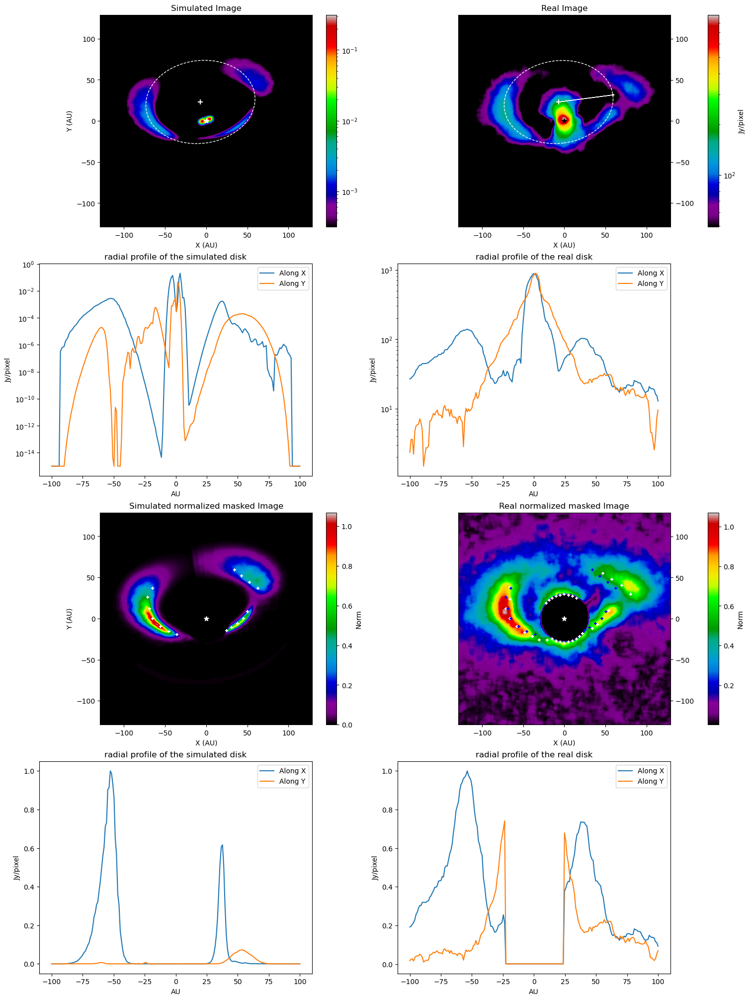

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from decimal import Decimal
import matplotlib.patches as ptch
import tools
import importlib

importlib.reload(tools)

# Choose a pixel coordination for comparison,  1 pixel = 1.23 au
# a1, b1 = -40, 0     #(x,y) going from [-100, 100]   x
# a2, b2 = 0, -40     #(x,y)                          .
# a3, b3 = 70, 30     #(x,y)                          +

simu_data = np.where(simu_data<10**(-15),10**-15 , simu_data.copy())
# c_data = np.where(c_data<13, 1, c_data.copy())

# Display all images 
fig, ax = plt.subplots(4, 2, figsize=(15, 20), constrained_layout=True)

#FIG1
im1 = ax[0,0].imshow(simu_data,interpolation=interpolation,cmap='nipy_spectral',norm=norm,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
ax[0,0].set_title('Simulated Image')
# ax[0,0].scatter(round(a1*1.23), round(b1*1.23), color='white', s=50, marker='x')
# ax[0,0].scatter(round(a2*1.23), round(b2*1.23), color='white', s=50, marker='.')
# ax[0,0].scatter(round(a3*1.23), round(b3*1.23), color='white', s=50, marker='+')
ax[0,0].set_xlabel('X (AU)')
ax[0,0].set_ylabel('Y (AU)')
ax[0,0].axis('on')
#Ellipse fit
ellipse = ptch.Ellipse(xy=[-7, 23], width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[0,0].add_patch(ellipse)
ax[0,0].scatter(-7, 23, color='white', s=50, marker='+')
ax[0,0].scatter(0, 0, color='white', s=50, marker='*')
# ellipse = ptch.Ellipse(xy=[0,0], width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
# ax[0,0].add_patch(ellipse)

fig.colorbar(im1, ax=ax[0,0], location='right')

#FIG2
im2 = ax[0,1].imshow(c_data,cmap = 'nipy_spectral',interpolation  = 'bicubic', norm=LogNorm(vmin=intmin, vmax=intmax),origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
ax[0,1].set_title('Real Image')
# ax[0,1].scatter(round(a1 *1.23), round(b1*1.23), color='white', s=50, marker='x')
# ax[0,1].scatter(round(a2 *1.23), round(b2*1.23), color='white', s=50, marker='.')
# ax[0,1].scatter(round(a3 *1.23), round(b3*1.23), color='white', s=50, marker='+')
ax[0,1].set_xlabel('X (AU)')
ax[0,1].yaxis.tick_right()
ax[0,1].axis('on')
#Ellipse fit [best fit: extracted from Follette et al. e=66, a=0.49", b=0.37", PA=97, center=(-5,+18)] -> converted pixel, arcsec into au (*136pc | *1.23 au/pixel)
center_au=[-7, 23]
ellipse = ptch.Ellipse(xy=center_au, width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[0,1].add_patch(ellipse)
# mask = ptch.Circle(xy=(0,0),radius=26,color='black',fill=True)
# ax[0,1].add_patch(mask)
ax[0,1].scatter(center_au[0], center_au[1], color='white', s=50, marker='+')
ax[0,1].scatter(0, 0, color='black', s=50, marker='*')
# End point calculation for the semi-major axis vector, considering the rotation
end_point_x = center_au[0] + 54*1.23 * math.cos(np.deg2rad(7.4))
end_point_y = center_au[1] + 54*1.23 * math.sin(np.deg2rad(7.4))
ax[0,1].arrow(center_au[0], center_au[1], end_point_x - center_au[0], end_point_y - center_au[1], head_width=2, head_length=2, fc='white', ec='white')

fig.colorbar(im2, ax=ax[0,1], location='right', label='Jy/pixel')

#Fifure 3,4 display intensity values allong 1 dim array

pos1, pos2 = -100, +100       # along x, default y = 100 (middle)
pos1 += 100
pos2 += 100 

#FIG3
s_int_max = simu_data[100,pos1:pos2]
simu_len = len(s_int_max)
ax[1, 0].plot(np.linspace(pos1-100,pos2-100,simu_len),s_int_max, label='Along X')
s_int_max = simu_data[pos1:pos2, 100]
ax[1, 0].plot(np.linspace(pos1-100,pos2-100,simu_len),s_int_max, label='Along Y')
ax[1, 0].set_title('radial profile of the simulated disk')
ax[1, 0].set_yscale('log')
ax[1, 0].set_xlabel('AU')
ax[1, 0].set_ylabel('Jy/pixel')
ax[1, 0].legend()
#FIG4
r_int_max = c_data[100,pos1:pos2]
r_len     = len(r_int_max)
ax[1, 1].plot(np.linspace(pos1-100,pos2-100,r_len), r_int_max, label='Along X')
r_int_max = c_data[pos1:pos2, 100]
ax[1, 1].plot(np.linspace(pos1-100,pos2-100,r_len), r_int_max, label='Along Y')
ax[1, 1].set_title('radial profile of the real disk')
ax[1, 1].set_yscale('log')
ax[1, 1].set_xlabel('AU')
ax[1, 1].set_ylabel('Jy/pixel')
ax[1, 1].legend()


'''Fiure 5,6,7,8 normalized masked IMAGES/PLOTS'''


new_simu_data = tools.circular_mask(simu_data, radius=23)
new_c_data = tools.circular_mask(c_data, radius=23)

nor_simu_data = new_simu_data / np.max(new_simu_data, axis=1)[100]           #NORMALIZATION
nor_c_data = new_c_data / np.max(new_c_data, axis=1)[100]                    #NORMALIZATION

#1dim array range
pos1, pos2 = -100, +100       # along x, default y = 100 (middle)
pos1 += 100
pos2 += 100 

#FIG5
im3 = ax[2,0].imshow(nor_simu_data,cmap = 'nipy_spectral',interpolation='bicubic',norm=None,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
ax[2,0].set_title('Simulated normalized masked Image')
ax[2,0].set_xlabel('X (AU)')
ax[2,0].set_ylabel('Y (AU)')
ax[2,0].axis('on')
ax[2,0].scatter(0, 0, color='white', s=50, marker='*')
fig.colorbar(im3, ax=ax[2,0], location='right', label='Norm')
tools.trace_outer_ring(nor_simu_data,ax=ax, grid_x= 2, grid_y=0,int_threshold=0.2)
# tools.trace_outer_ring(nor_c_data,ax=ax, grid_x= 2, grid_y=0,int_threshold=0.5, color='blue')

#FIG6
im4 = ax[2,1].imshow(nor_c_data,cmap = 'nipy_spectral',interpolation='bicubic', norm=None,origin='lower', extent=[-new_size_au/2.0, new_size_au/2.0, -new_size_au/2.0, new_size_au/2.0])
ax[2,1].set_title('Real normalized masked Image')
ax[2,1].set_xlabel('X (AU)')
ax[2,1].yaxis.tick_right()
ax[2,1].axis('on')
ax[2,1].scatter(0, 0, color='white', s=50, marker='*')
fig.colorbar(im4, ax=ax[2,1], location='right', label='Norm')
max_intensity_points1 =tools.trace_outer_ring(nor_c_data,ax=ax, grid_x= 2, grid_y=1,int_threshold=0.50)
max_intensity_points2 =tools.trace_outer_ring(nor_simu_data,ax=ax, grid_x= 2, grid_y=1,int_threshold=0.2,color = 'blue')


#FIG7
s_int_max = nor_simu_data[100,pos1:pos2]
simu_len = len(s_int_max)
ax[3, 0].plot(np.linspace(pos1-100,pos2-100,simu_len),s_int_max, label= 'Along X')
s_int_max = nor_simu_data[pos1:pos2, 100]
ax[3, 0].plot(np.linspace(pos1-100,pos2-100,r_len), s_int_max, label='Along Y')
ax[3, 0].set_title('radial profile of the simulated disk')
# ax[3, 0].set_yscale('log')
ax[3, 0].set_xlabel('AU')
ax[3, 0].set_ylabel('Jy/pixel')
ax[3, 0].legend()

#FIG8
r_int_max = nor_c_data[100,pos1:pos2]
r_len     = len(r_int_max)
ax[3, 1].plot(np.linspace(pos1-100,pos2-100,r_len), r_int_max, label='Along X')
r_int_max = nor_c_data[pos1:pos2, 100]
ax[3, 1].plot(np.linspace(pos1-100,pos2-100,r_len), r_int_max, label='Along Y')
ax[3, 1].set_title('radial profile of the real disk')
# ax[3, 1].set_yscale('log')
ax[3, 1].set_xlabel('AU')
ax[3, 1].set_ylabel('Jy/pixel')
ax[3, 1].legend()




plt.show()


# # Display the intensity values 
# pixel_comparison = pd.DataFrame({
#     'Image': ['Simulated', 'Real'],
#     'Intensity Value x': ["{:.2E}".format(simu_data[a1+100, b1+100]), "{:.2E}".format(c_data[a1+100, b1+100])],
#     'Intensity Value ·': ["{:.2E}".format(simu_data[a2+100, b2+100]), "{:.2E}".format(c_data[a2+100, b2+100])],
#     'Intensity Value +': ["{:.2E}".format(simu_data[a3+100, b3+100]), "{:.2E}".format(c_data[a3+100, b3+100])]
# })

# pixel_comparison
# # np.shape(simu_data)


In [ ]:
fig, ax = plt.subplots(4, 2, figsize=(15, 20), constrained_layout=True)
#FIG1
im1 = ax[0,0].imshow(simu_data,interpolation=interpolation,cmap='nipy_spectral',norm=norm,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
ax[0,0].set_title('Simulated Image')
ax[0,0].set_xlabel('X (AU)')
ax[0,0].set_ylabel('Y (AU)')
ax[0,0].axis('on')
    #Ellipse fit from Fellette et al. 2015
ellipse = ptch.Ellipse(xy=[-7, 23], width=2*66.64, height=2*50.32,angle=7.4, edgecolor='white', fc='None', ls='--')
ax[0,0].add_patch(ellipse)
ax[0,0].scatter(-7, 23, color='white', s=50, marker='+')
ax[0,0].scatter(0, 0, color='white', s=50, marker='*')

fig.colorbar(im1, ax=ax[0,0], location='right')

# MAKING A MOVIE WITH THE PLOTS

## 1. Create movie.inp file         

In [162]:
import os
from tools import manage_image_files

total_frames = 360

delete_files = True  # Change to False if you just want to check for remaining files

manage_image_files(total_frames, delete_files)

hsx, hsy = 1e15, 1e15  # Half-size values
pa, incl = 0, 60  # Position angle and inclination
# file_movie = 
# Open the file and write the header and data lines
with open('movie.inp', 'w') as f:
    f.write('1\n')  # Header part 1: Version or identifier
    f.write(f'{total_frames}\n')  # Header part 2: Total number of frames
    # Loop through each frame and write the corresponding line
    for frame in range(1, total_frames + 1):
        line = f"0. 0. 0. {hsx} {hsy} {pa}. {incl}.  {frame}.\n"
        f.write(line)

Deleted /Users/pbo/Desktop/Bosse_Internship_Project/radmc_for_ppdisk_English_ver1.0/inc_scattering/movie/image_0001.out
Deleted /Users/pbo/Desktop/Bosse_Internship_Project/radmc_for_ppdisk_English_ver1.0/inc_scattering/movie/image_0002.out
Deleted /Users/pbo/Desktop/Bosse_Internship_Project/radmc_for_ppdisk_English_ver1.0/inc_scattering/movie/image_0003.out
Deleted /Users/pbo/Desktop/Bosse_Internship_Project/radmc_for_ppdisk_English_ver1.0/inc_scattering/movie/image_0004.out
All specified image files successfully deleted, no additional matching files found.


## 2. Call radmc3d movie cmd

In [163]:
os.system('radmc3d movie lambda 1.6 npix 400 sizeau 200 incl 50 posang 0 nphot_scat 1000000 stokes setthreads 8')

  
      WELCOME TO RADMC-3D: A 3-D CONTINUUM AND LINE RT SOLVER    
                                                                 
                          VERSION 2.0                            
                                                                 
                (c) 2008-2023 Cornelis Dullemond                 
                                                                 
       Please feel free to ask questions. Also please report     
        bugs and/or suspicious behavior without hestitation.     
      The reliability of this code depends on your vigilance!    
                    dullemond@uni-heidelberg.de                  
                                                                 
   To keep up-to-date with bug-alarms and bugfixes, follow the   
                     RADMC-3D code on github                     
             https://github.com/dullemond/radmc3d-2.0            
                                                                 
       

0

### 2.1. Redirect movie files in movie diretory

In [164]:
import shutil

source_dir = '.'  # Current directory
destination_dir = os.path.expanduser('/Users/pbo/Desktop/Bosse_Internship_Project/radmc_for_ppdisk_English_ver1.0/inc_scattering/movie')  # Expands ~ to the home directory

# Ensure the destination directory exists; create it if it doesn't
os.makedirs(destination_dir, exist_ok=True)

# Loop through each frame number
for i in range(1, total_frames + 1):  
    file_name = f"image_{i:04d}.out"
    source_path = os.path.join(source_dir, file_name)
    destination_path = os.path.join(destination_dir, file_name)
    
    # Move the file
    if os.path.exists(source_path):  # Check if the file exists before trying to move it
        shutil.move(source_path, destination_path)
    else:
        print(f"File {file_name} not found.")

# os.path.expanduser('~/movie')

## 3. Make the movie

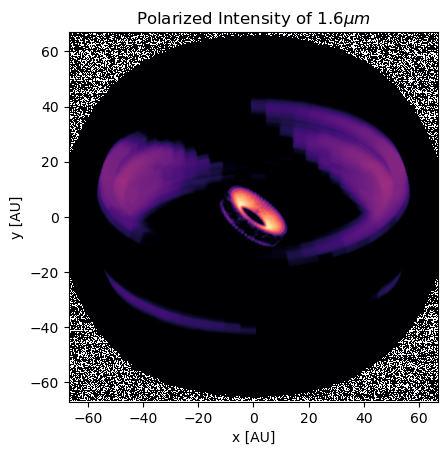

In [165]:
import matplotlib.pyplot as plt
from matplotlib import animation
from radmc3dPy import *
import numpy as np
import math
from matplotlib.colors import LogNorm

dpc = 138
frame_numbers = [f"movie/image_{i:04d}.out" for i in range(1, total_frames + 1)]  # Adjusted to include frames

# Set up the figure and axis for the animation
fig, ax = plt.subplots()  # Simplified subplot creation

def update_frame(i):
    ax.clear()  # Clear the previous frame
    fname = frame_numbers[i]
    rangeim = 67
    imrangeau      =  [-rangeim,rangeim,-rangeim,rangeim]
    with open(fname,'r') as f:
        s        = f.readline()
        im_n      = f.readline()
        im_nx     = int(im_n.split()[0])
        im_ny     = int(im_n.split()[1])
        nlam      = int(f.readline())
        pixsize   = f.readline()
        pixsize_x = float(pixsize.split()[0])
        pixsize_y = float(pixsize.split()[1])
        wavelength_mic = np.zeros(nlam)
        im    = np.zeros((im_nx,im_ny,4,nlam)) #[MODIFIED] array dimension modified for Stokes I,Q,U,V
        rr_au = np.zeros((im_nx,im_ny,4,nlam)) #[MODIFIED] array dimension modified for Stokes I,Q,U,V
        phi   = np.zeros((im_nx,im_ny,4,nlam)) #[MODIFIED] array dimension modified for Stokes I,Q,U,V
        for ilam in range(nlam): wavelength_mic[ilam] = f.readline()
        for ilam in range(nlam):
            dummy = f.readline() #blank line
            for iy in range(im_ny):
                for ix in range(im_nx):
                    image_temp = f.readline()
                    im[ix,iy,:,ilam] = [image_temp.split()[istokes] for istokes in [0,1,2,3]] #[MODIFIED] array dimension modified for Stokes I,Q,U,V
                    rr_au[ix,iy,ilam] = np.sqrt(((ix-im_nx/2)*pixsize_x)**2+((iy-im_ny/2)*pixsize_y)**2)/au
                    phi[ix,iy,ilam]   = np.arctan2((iy-im_ny/2)*pixsize_y,(ix-im_nx/2)*pixsize_x) 
    sizex_au = im_nx*pixsize_x/au
    sizey_au = im_ny*pixsize_y/au

    #polarized intensity is stored in the array im_PI
    im_PI = np.zeros((im_nx,im_ny,nlam,4))
    im_PI = ((im[:,:,1,0])**2.0 + (im[:,:,2,0])**2.0)**0.5

    d_pc = 138.0

    conv          = pixsize_x * pixsize_y / (d_pc*pc)**2. * 1e23 
    im_PI_forplot = im_PI.copy()*conv
    pltunit       = '[Jy/pix]'

    # fontsize       = 12
    # fontfamily     = 'serif'
    interpolation  = 'bicubic'
    cmap           = 'magma'
    intmax         =  np.max(im_PI_forplot)
    intmin         =  np.max(im_PI_forplot)*0.001
    # tickcolor      = 'white'
    xlabel         = 'x [AU]'
    ylabel         = 'y [AU]'
    norm           =  None
    # drawpolvect    =  False
    title          = f'Polarized Intensity of {float(wavelength_mic[0])}$\mu m$' 

    # fig2=plt.figure(num=None, figsize=(8,6), dpi=200, facecolor='w', edgecolor='k')
    # ax2=fig2.add_subplot(111)
    norm=LogNorm(vmin=intmin, vmax=intmax)
    plt.imshow(im_PI_forplot[:,:].T,interpolation=interpolation,cmap=cmap,norm=norm,origin='lower',extent= [-sizex_au/2.0,sizex_au/2.0,-sizey_au/2.0,sizey_au/2.0])
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    
    plt.xlim(imrangeau[0],imrangeau[1])
    plt.ylim(imrangeau[2],imrangeau[3])
    plt.title(title)
    # plt.tick_params(which='major', color=tickcolor,width=2.0,length=6.0)
    # plt.text(x=30, y=-90, s=f"Inclination: {incl_value}°, Position Angle: {posang_value}°", fontsize=6, bbox=dict(facecolor='white', alpha=1))
    #cbar=plt.colorbar()
    #cbar.set_label(pltunit)

    return fig,


# Create the animation
ani = animation.FuncAnimation(fig, update_frame, frames=range(total_frames), blit=False)  # Adjusted frame range

# # Save the animation
ani.save('movie2.mp4', writer='ffmpeg', fps=24)

# plt.close()  # Close the plot to prevent it from displaying in notebooks or interactive environments

